In [2]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np

# 1

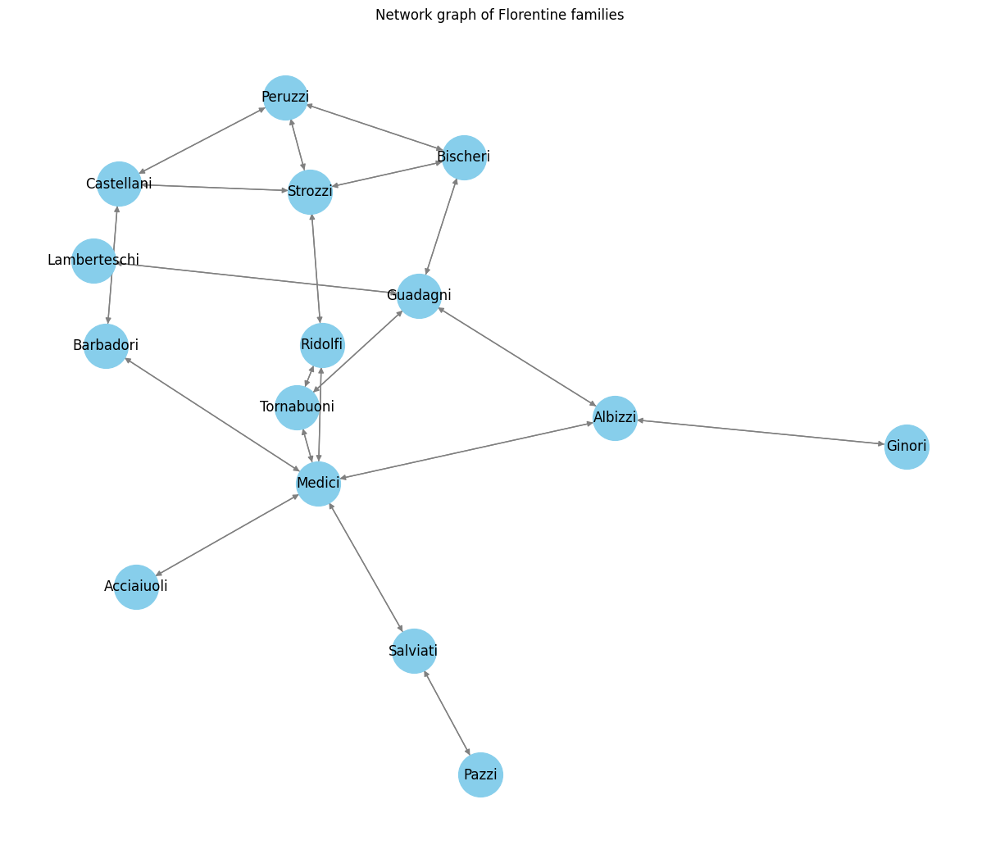

In [10]:
df1 = pd.read_csv('firenze.csv')
edges = []
for i in df1.columns:
    for j in df1.index:
        if df1.loc[j, i] == 1:
            edges.append((i, j))

G = nx.DiGraph()
G.add_edges_from(edges)

G.remove_edges_from(nx.selfloop_edges(G))

plt.figure(figsize=(12, 10))
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_color='gray')
plt.title("Network graph of Florentine families")
plt.show()


/tmp/ipykernel_22091/3010864945.py:5: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



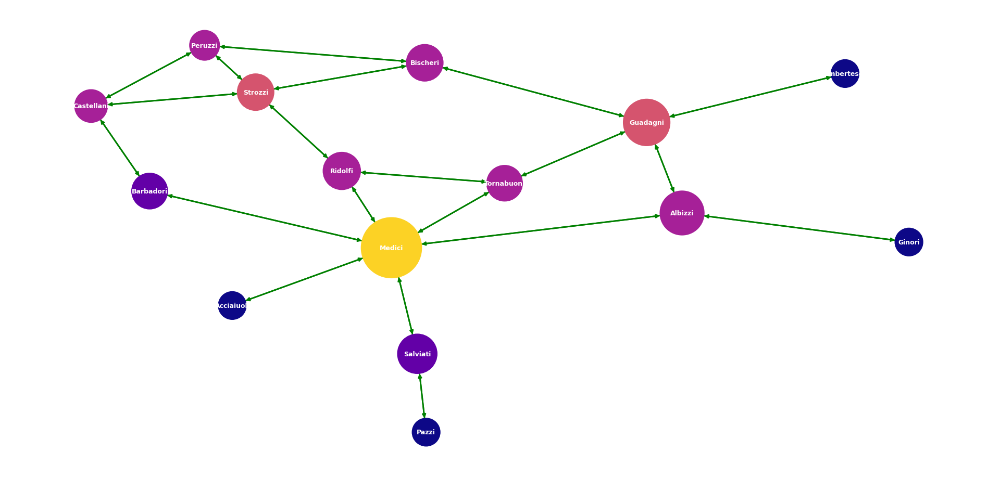

In [11]:
def rescale(l, newmin, newmax):
    arr = list(l)
    return [(x - min(arr)) / (max(arr) - min(arr)) * (newmax - newmin) + newmin for x in arr]

graph_colormap = cm.get_cmap('plasma', 12)  

c = rescale([G.degree(v) for v in G], 0.0, 0.9)  
c = [graph_colormap(i) for i in c]

bc = nx.betweenness_centrality(G)  
s = rescale([v for v in bc.values()], 1500, 7000)

pos = nx.spring_layout(G)
plt.figure(figsize=(19, 9), facecolor=[0.7, 0.7, 0.7, 0.4])
nx.draw(G, pos=pos, with_labels=True, node_color=c, node_size=s, edge_color='green', width=2,
        font_color='white', font_weight='bold', font_size=9)

plt.axis('off')
plt.show()


# 2

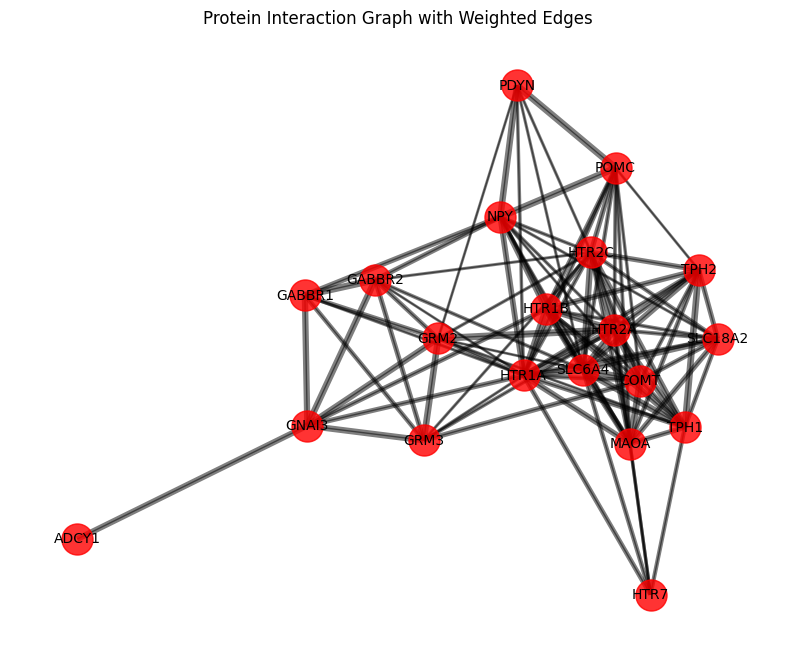

In [5]:
df2 = pd.read_csv('dothi3.csv')

df_filtered = df2[['preferredName_A', 'preferredName_B', 'score']]

df_array = np.array(df_filtered)

G = nx.Graph(name='Protein Interaction Graph')

for i in range(len(df_array)):
    a = df_array[i][0]
    b = df_array[i][1] 
    w = float(df_array[i][2]) 
    G.add_weighted_edges_from([(a, b, w)])

plt.figure(figsize=(10, 8))
pos = nx.spring_layout(G)  
edges = G.edges(data=True)
weights = [edge[2]['weight'] for edge in edges]
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w*5 for w in weights], alpha=0.5, edge_color='black')


nx.draw_networkx_nodes(G, pos, node_size=500, node_color='red', alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=10)
plt.title("Protein Interaction Graph with Weighted Edges")
plt.axis('off')  
plt.show()

# 3

In [6]:
import json
df3 = pd.read_csv("Vietnam.csv")

with open('vietnam.geojson', 'r', encoding='utf-8') as f:
    vietnam_geojson = json.load(f)

fig = px.choropleth(df3,
                    geojson=vietnam_geojson,
                    locations='id',
                    featureidkey="properties.id_1",
                    color='province',
                    hover_name='province',
                    title="Population Distribution in Vietnam",
                    color_continuous_scale="Viridis")

fig.update_geos(fitbounds="locations", visible=False)
fig.show()


In [7]:
df32 = pd.read_csv('covid_hoanchinh.csv')
fig = px.choropleth(
    data_frame=df32,
    locations="ISO",  
    color="Deaths per Million",  
    hover_name="Country",  
    color_continuous_scale=px.colors.sequential.YlOrRd,  
    projection="natural earth"
)

fig.show()

In [8]:
fig = px.choropleth(
    data_frame=df32,
    locations="ISO",  
    color="Cases per Million",  
    hover_name="Country",  
    color_continuous_scale=px.colors.sequential.Plasma, 
    projection="natural earth"  
)

fig.show()

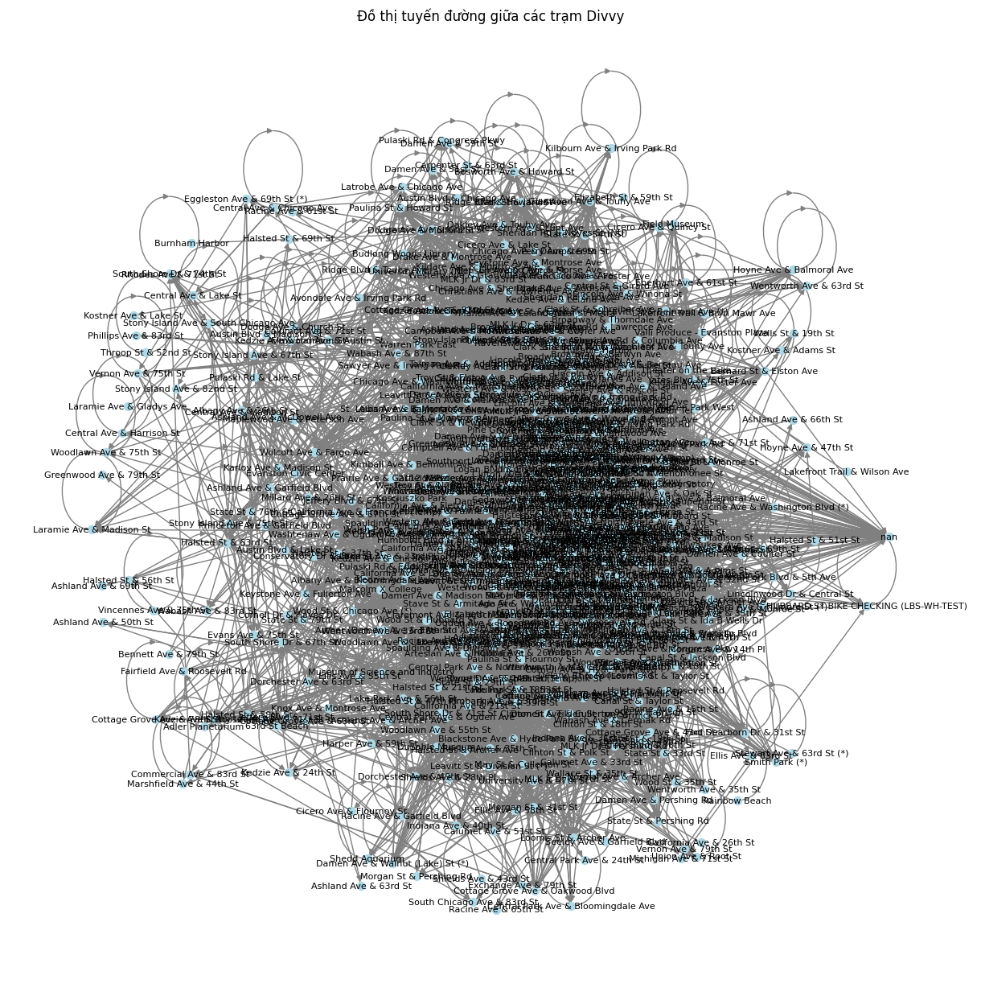

In [11]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Đọc dữ liệu từ tệp CSV
data = pd.read_csv('202004-divvy-tripdata.csv')

# Lọc các cột liên quan đến trạm bắt đầu và trạm kết thúc
routes = data[['start_station_name', 'end_station_name']]

# Tạo đồ thị có hướng
G = nx.DiGraph()

# Thêm các cạnh từ trạm bắt đầu tới trạm kết thúc
for idx, row in routes.iterrows():
    G.add_edge(row['start_station_name'], row['end_station_name'])

# Vẽ đồ thị
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, k=0.5, iterations=50)
nx.draw(G, pos, with_labels=True, node_size=50, node_color='lightblue', font_size=8, edge_color='gray', arrows=True)
plt.title("Đồ thị tuyến đường giữa các trạm Divvy")
plt.show()